In [4]:
from astropy.io import fits
from destretch import *
from matplotlib.animation import FuncAnimation
from IPython import display
pl.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'

In [42]:
Hdu = fits.open("test/test.fits")
test_data = Hdu[0].data
test_data /= np.mean(test_data)
med = np.median(test_data, axis=0)

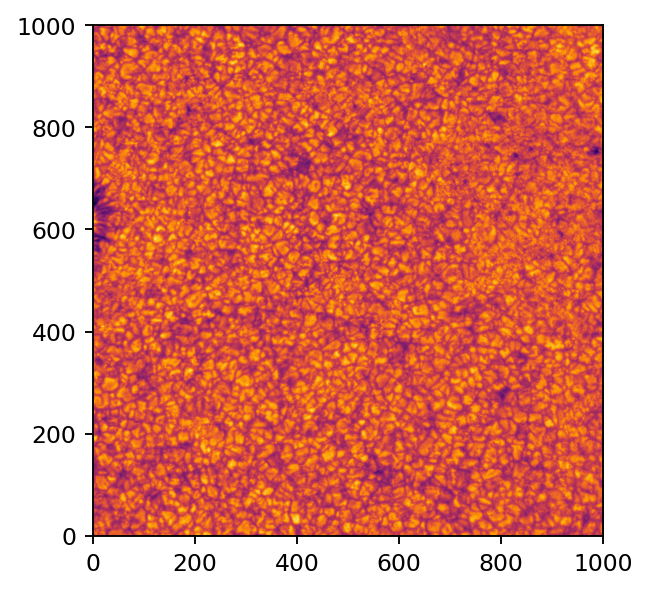

In [47]:
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(test_data[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(test_data[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [48]:
display.HTML(anim.to_jshtml())

In [39]:
kernel_sizes = [100, 64, 32]
reference = np.median(test_data, axis=0)
ans = np.zeros(test_data.shape)

for i in range(11):
    scene = test_data[i]
    ans[i], disp, rdisp, d_info = reg_loop(scene, reference, kernel_sizes)

Total destr took: 0.19895482063293457 seconds for kernel of size 100 px.
Total destr took: 0.26497960090637207 seconds for kernel of size 64 px.
Total destr took: 0.31492114067077637 seconds for kernel of size 32 px.
Total elapsed time 1.8830885887145996 seconds.
Total destr took: 0.2243943214416504 seconds for kernel of size 100 px.
Total destr took: 0.3068974018096924 seconds for kernel of size 64 px.
Total destr took: 0.27957701683044434 seconds for kernel of size 32 px.
Total elapsed time 1.936741828918457 seconds.
Total destr took: 0.21997928619384766 seconds for kernel of size 100 px.
Total destr took: 0.25123143196105957 seconds for kernel of size 64 px.
Total destr took: 0.306591272354126 seconds for kernel of size 32 px.
Total elapsed time 1.909120798110962 seconds.
Total destr took: 0.21166467666625977 seconds for kernel of size 100 px.
Total destr took: 0.23815679550170898 seconds for kernel of size 64 px.
Total destr took: 0.3124403953552246 seconds for kernel of size 32 px

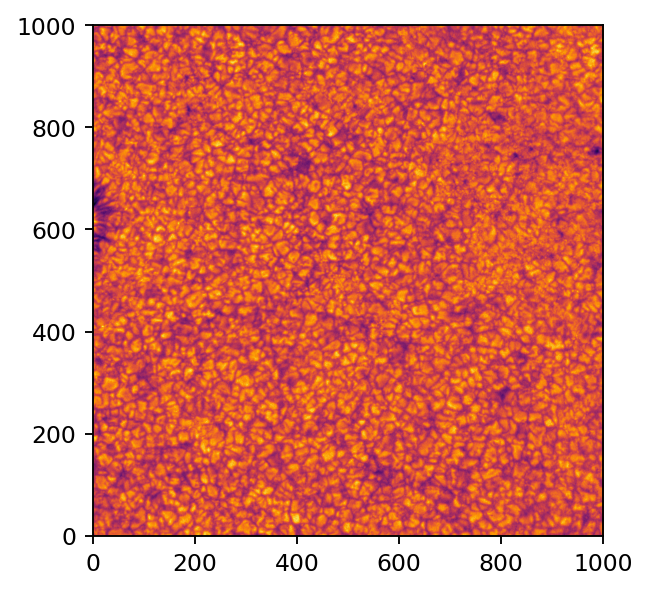

In [49]:
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(ans[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(ans[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [50]:
display.HTML(anim.to_jshtml())